In [1]:
import os
import math
import shutil
import cv2
import imagehash
from PIL import Image
import matplotlib.pyplot as plt
from skimage.metrics import mean_squared_error

plt.rcParams['figure.figsize'] = (12, 8)

In [2]:
DATASETS_PATH = 'c:/Users/Groot/Code/oral_cancer/datasets'
MODIFIED_DATA  = 'c:/Users/Groot/Code/oral_cancer/modified'

In [3]:
def get_dataset_size(path):
    num_of_images = {}
    for folder in os.listdir(path):
        folder_path = os.path.join(path, folder)

        num_images_in_folder = len(os.listdir(folder_path))

        num_of_images[folder] = num_images_in_folder

    return num_of_images

In [4]:
def compute_hash(image_path):

    with Image.open(image_path) as img:
        hash_value = imagehash.phash(img)
    return hash_value

In [5]:
def find_del_dupl_img(file_name, file_dir):

    searched_img_path = os.path.join(file_dir, file_name)
    
    if not os.path.exists(searched_img_path):
        return

    searched_hash = compute_hash(searched_img_path)

    duplicate_found = False
    
    for cmp_image_name in os.listdir(file_dir):
        cmp_image_path = os.path.join(file_dir, cmp_image_name)

        if cmp_image_name == file_name:
            continue

        if not os.path.isfile(cmp_image_path):
            continue

        try:
            cmp_hash = compute_hash(cmp_image_path)
            hash_distance = searched_hash - cmp_hash
        except Exception as e:
            continue

        if hash_distance < 5: 
            if not duplicate_found:
                fig = plt.figure(figsize=(6, 3))
                duplicate_found = True
            
            ax1 = fig.add_subplot(1, 2, 1)
            ax1.imshow(cv2.imread(searched_img_path, cv2.IMREAD_GRAYSCALE), cmap='gray')
            ax1.set_title("Searched Image")

            ax2 = fig.add_subplot(1, 2, 2)
            ax2.imshow(cv2.imread(cmp_image_path, cv2.IMREAD_GRAYSCALE), cmap='gray')
            ax2.set_title("Duplicate Image to be Removed")

            try:
                os.remove(cmp_image_path)
            except Exception as e:
                continue

    if duplicate_found:
        plt.tight_layout()
        plt.show()

In [6]:
def process_dataset(dataset_src, dataset_dest):
    shutil.copytree(dataset_src, dataset_dest)

    for folder in os.listdir(dataset_dest):
        for (index, file) in enumerate(os.listdir(os.path.join(dataset_dest, folder)), start=1):

            original_filename, ext = os.path.splitext(file)
            filename = f'{original_filename}_ckd{ext}'
            img_src = os.path.join(dataset_dest, folder, file)
            img_des = os.path.join(dataset_dest, folder, filename)

            img_org = cv2.imread(img_src)
            cv2.imwrite(img_des, img_org)

            os.remove(img_src)

        for file in os.listdir(os.path.join(dataset_dest, folder)):
            find_del_dupl_img(file, os.path.join(dataset_dest, folder))

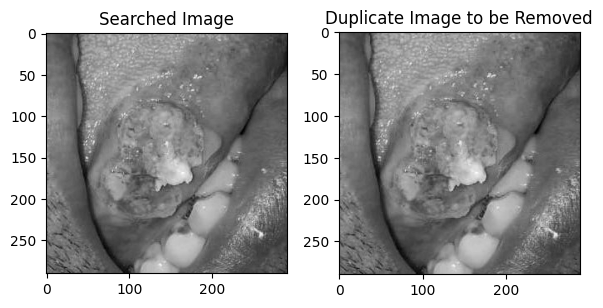

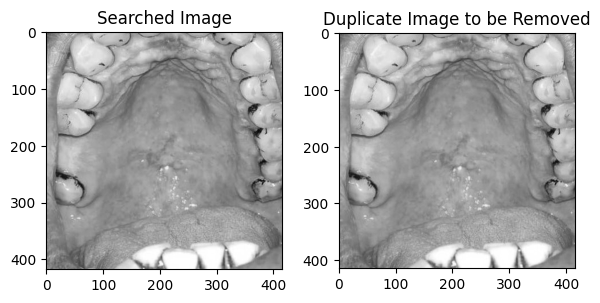

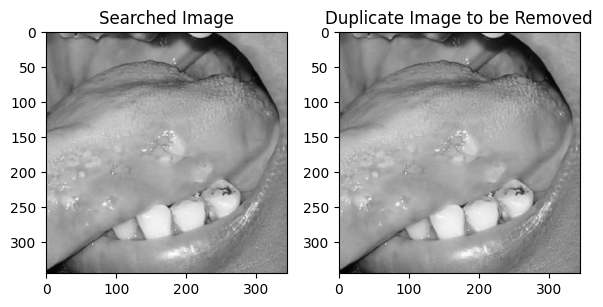

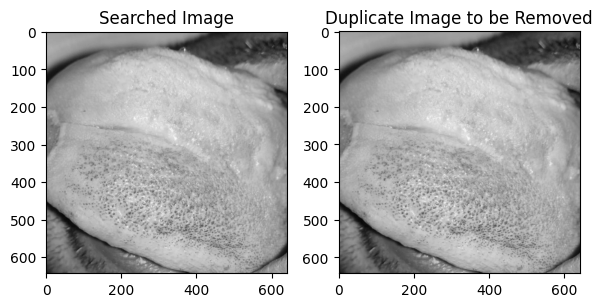

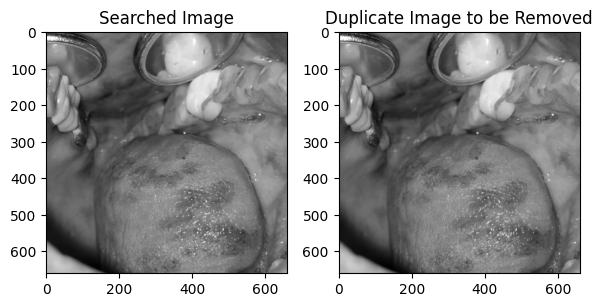

...

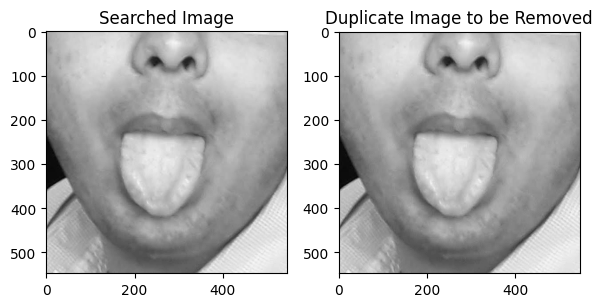

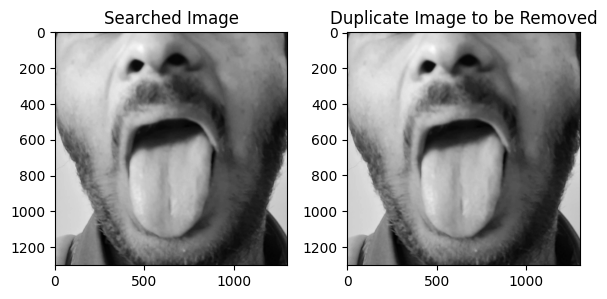

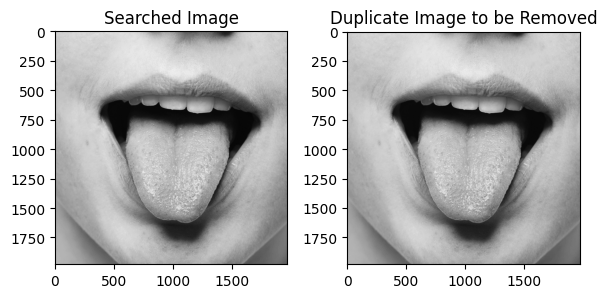

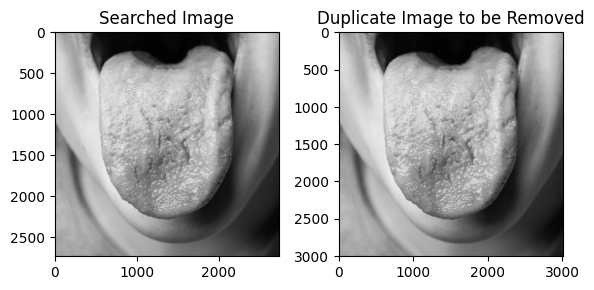

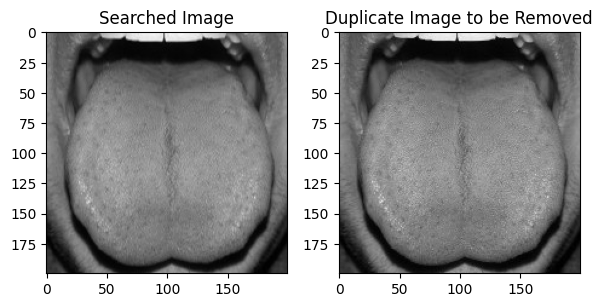

In [7]:
source_root_folder = MODIFIED_DATA +'/complete_dcm'
destination_root_folder = MODIFIED_DATA +'/hash_dcmd'
process_dataset(source_root_folder, destination_root_folder)  

In [8]:
print('Dataset Size:', get_dataset_size(MODIFIED_DATA +'/complete_dcm'))
print('Dataset Size:', get_dataset_size(MODIFIED_DATA +'/hash_dcmd'))

Dataset Size: {'cancer': 680, 'non_cancer': 436}
Dataset Size: {'cancer': 548, 'non_cancer': 417}
